# Semester Project
## Adobtable Dogs in the US - Mattia Dell'Oca

**Author:** Dell'Oca Mattia

**Role:** student in Computer Science

**University:** SUPSI, Lugano (Switzerland), __[SUPSI.ch](https://www.supsi.ch)__

**Date:** 06/12/2022

**Mail:** mattia.delloca@student.supsi.ch

***

## Introduction
In this project I will analyze data related to dogs that are available for adoption in the USA.

The dataset I'm working on is taken from __[Kaggle.com](https://www.kaggle.com)__  ----> __[dataset](https://www.kaggle.com/datasets/thedevastator/adoptable-dogs-in-the-us)__

The data were gathered from a popular social network called Petfinder that help user to either adopt a dog or find a new home for their four paws friend. There are about 58k entries in the dataset, each one representing a different dog.

In this analysis I will try to answers to the following questions:
 - What is the distribution of dogs' gender, size and age?
 - How many dogs are thoroughbred? For thoroughbred dogs, which breeds are the most common?
 - What are the most common names for dogs? Do the names change in relation to the dog size?
 - Is there are difference in the percentage of house trained dogs given their size?
 - Is there are difference in dogs' coat length given the temperature of the state?
 - Where do the dogs come from?
 - Is there a difference in the percetage of vaccinated dogs given the state? And what about the percentage of thoroughbred dogs?
 - Do the most common words used for describing dogs change accordingly to the dog age or breed?

Let's start with the analysis!

***

## Notebook setup

First of all, we need to import our data

In [1]:
import pandas as pd
import plotly.express as px
df = pd.read_csv("data/allDogDescriptions.csv")

### Dataset details

In [2]:
print("Total columns: ", len(df.columns))
print("Column names: ", df.columns)
print("Sample: ")
df.sample(5)

Total columns:  36
Column names:  Index(['index', 'id', 'org_id', 'url', 'type.x', 'species', 'breed_primary',
       'breed_secondary', 'breed_mixed', 'breed_unknown', 'color_primary',
       'color_secondary', 'color_tertiary', 'age', 'sex', 'size', 'coat',
       'fixed', 'house_trained', 'declawed', 'special_needs', 'shots_current',
       'env_children', 'env_dogs', 'env_cats', 'name', 'status', 'posted',
       'contact_city', 'contact_state', 'contact_zip', 'contact_country',
       'stateQ', 'accessed', 'type.y', 'description'],
      dtype='object')
Sample: 


,index,id,org_id,url,type.x,species,breed_primary,breed_secondary,breed_mixed,breed_unknown,...,status,posted,contact_city,contact_state,contact_zip,contact_country,stateQ,accessed,type.y,description
29481,29481,45631095,IL181,https://www.petfinder.com/dog/titan-45631095/i...,Dog,Dog,Black Labrador Retriever,NaN,True,False,...,adoptable,2019-08-15T22:34:43+0000,Springfield,IL,62703,US,IL,2019-09-20,Dog,This pup is probably around 6 months old
49165,49165,42411935,OK406,https://www.petfinder.com/dog/eli-42411935/ok/...,Dog,Dog,Chihuahua,Boston Terrier,True,False,...,adoptable,2018-08-08T00:50:57+0000,Mustang,OK,73064,US,OK,2019-09-20,Dog,"This little guy may be a senior, but he has a ..."
10764,10764,45844393,CT560,https://www.petfinder.com/dog/caress-45844393/...,Dog,Dog,Husky,NaN,True,False,...,adoptable,2019-09-03T01:12:20+0000,Pomfret Center,CT,06259,US,CT,2019-09-20,Dog,BREED EXPERIENCE NECESSARY FOR ADOPTION
29485,29485,45626096,IL11,https://www.petfinder.com/dog/harlow-45626096/...,Dog,Dog,Australian Cattle Dog / Blue Heeler,Mixed Breed,True,False,...,adoptable,2019-08-15T17:06:35+0000,Pekin,IL,61554,US,IL,2019-09-20,Dog,This little fox i mean pup is Harlow. He is a ...
51513,51513,46005071,TN917,https://www.petfinder.com/dog/grover-46005071/...,Dog,Dog,Pomeranian,NaN,False,False,...,adoptable,2019-09-17T00:47:06+0000,White House,TN,37188,US,TN,2019-09-20,Dog,"Grover is a happy-go-lucky, sweet, friendly li..."


Among all the columns, I will mostly focus on the followings:
 - **index:**  dataset index
 - **id:** unique indentifier for each dog
 - **breed_primary:** primary breed of the dog (used only for thoroughbred dogs)
 - **breed_mixed:** whether or not the dog is thoroughbred
 - **age:** age of the dog: the possible values are Baby, Young, Adult, Senior
 - **sex:** sex of the dog
 - **size:** size of the dog: the possible values are Small, Medium, Large, Extra Large
 - **coat:** coat length: the possible values are Short, Medium, Long
 - **house_trained:** whether or not the dog is house trained
 - **special_needs:** whether or not the dog has special needs
 - **shots_current:** whether or not the dog has recieved all the vaccinations it needs
 - **name:** name of the dog
 - **contact_state:** contact state (2 letters format)
 - **description:** description of the dog

In [3]:
# Remove entries with incorrect contact state
df = df.loc[df['contact_state'].str.len() == 2]
df = df.loc[df['sex'] != 'Unknown']

## General data

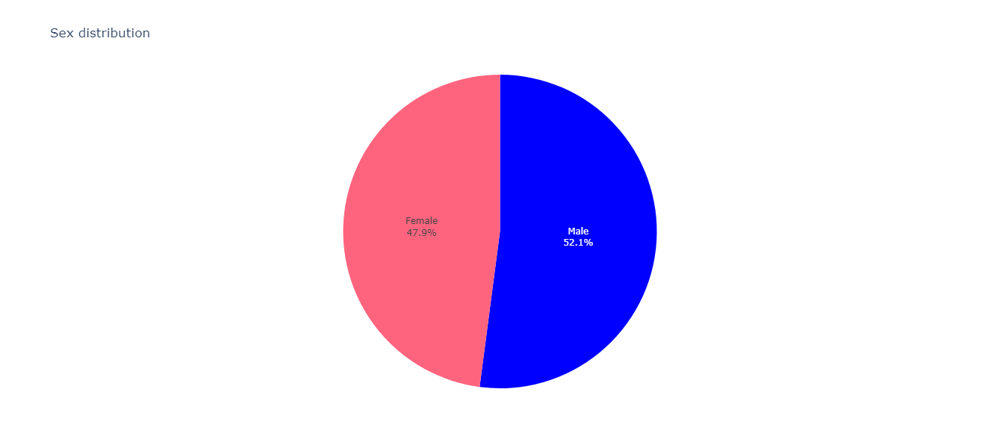

In [4]:
#1.1 Sex distribution

fig = px.pie(df, names = 'sex', color='sex', 
             title = 'Sex distribution',
            category_orders={'sex' : ["Male", "Female"]},
            color_discrete_sequence=['rgb(0, 0, 255)', 'rgb(255, 100, 127)'],
            height = 600)
fig.update_traces(textinfo='percent+label')
fig.update(layout_showlegend=False)
fig.show()

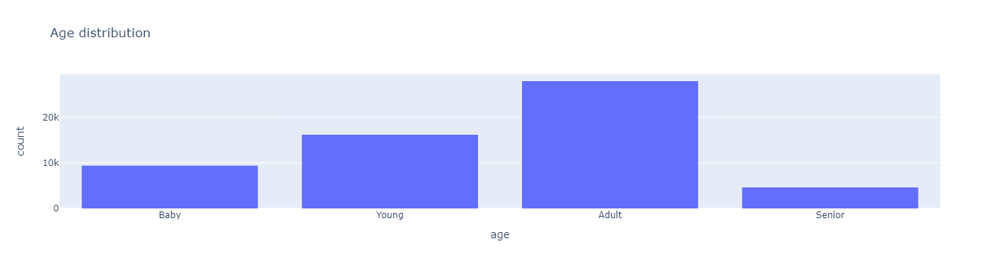

In [5]:
#1.2 Age distribution

fig = px.histogram(df, x='age', category_orders={'age' : ["Baby", "Young", "Adult", "Senior"]}, title = "Age distribution")
fig.show()

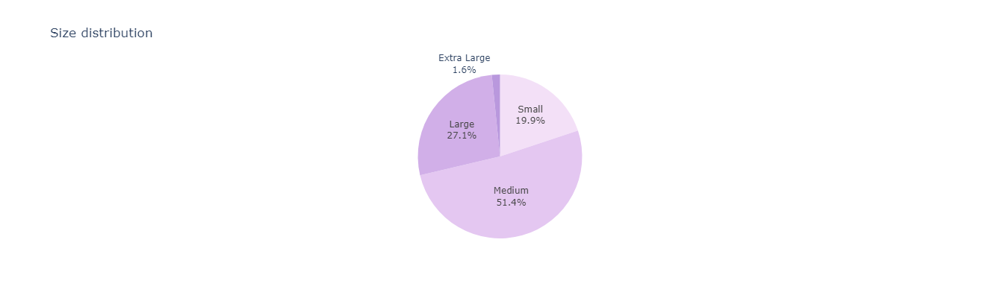

In [6]:
#1.3 Size distribution

fig = px.pie(df, names='size', color='size', title='Size distribution',
            category_orders={'size' : ["Small", "Medium", "Large", "Extra Large"]},
            color_discrete_sequence=px.colors.sequential.Purp,
            height = 400)
fig.update_traces(textinfo='percent+label')
fig.update(layout_showlegend=False)
fig.show()

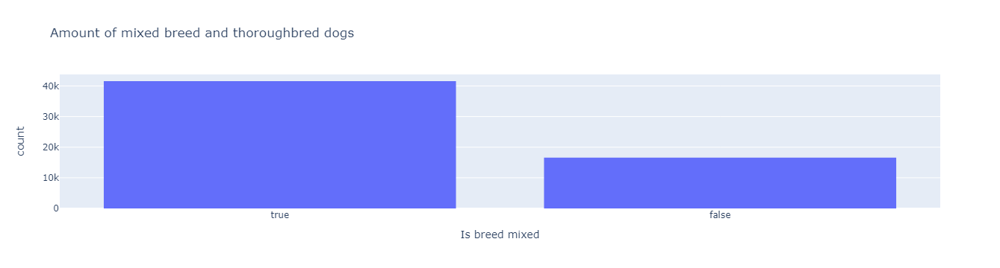

In [7]:
#1.3 Amount of mixed breed and thoroughbred dogs

fig = px.histogram(df, x = "breed_mixed", title="Amount of mixed breed and thoroughbred dogs")
fig.update_layout(xaxis={'title' : 'Is breed mixed'})
fig.show()

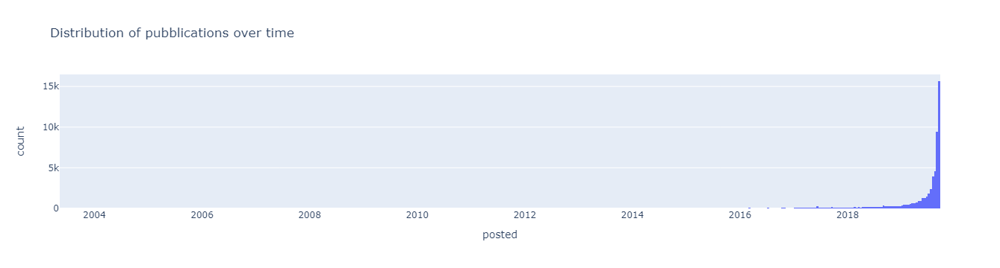

In [8]:
#1.4 Distribution of pubblications over time
df['posted'] = pd.to_datetime(df['posted'], errors='coerce')
dfd = pd.DataFrame(index=df.posted)
px.histogram(dfd, x=dfd.index, title="Distribution of pubblications over time")

This graph could seem a litle confusing at first sight, although it's meaning is queit straight foreword.
We have a count of insertion posted in intervalls of two weeks. Assuming that the amount of posts is similar over time, we can tell that every two weeks the amount of insertions decrease by almost an half.
This means that on average one on two dogs finds a new home in about two or three weeks!

***

## Thoroughbred analysis

Let's start by seeing how many different breeds are present in our dataset

In [9]:
#2.1 Breeds
tdf = df.loc[(df["breed_mixed"] == False) & (df['breed_primary'] != 'Mixed Breed')]   # thoroughbred dataframe
print('Number of different breeds: ', len(tdf["breed_primary"].unique()))
print('Breeds: ', tdf["breed_primary"].unique())

Number of different breeds:  184
Breeds:  ['Shepherd' 'German Shepherd Dog' 'Dachshund' 'Chihuahua' 'Cocker Spaniel'
 'Labrador Retriever' 'Terrier' 'Husky' 'Poodle' 'Jindo'
 'Pit Bull Terrier' 'Siberian Husky' 'Giant Schnauzer'
 'Miniature Pinscher' 'Wirehaired Terrier' 'Catahoula Leopard Dog'
 'Doberman Pinscher' 'Rat Terrier' 'Irish Terrier' 'Yorkshire Terrier'
 'Cairn Terrier' 'Pomeranian' 'Australian Shepherd' 'Retriever'
 'English Bulldog' 'Coonhound' 'Shar-Pei' 'American Staffordshire Terrier'
 'Beagle' 'Treeing Walker Coonhound' 'Xoloitzcuintli / Mexican Hairless'
 'Saint Bernard' 'Dogo Argentino' 'Boxer' 'American Bulldog'
 'French Bulldog' 'English Springer Spaniel' 'Standard Poodle' 'Akita'
 'Mastiff' 'Italian Greyhound' 'Belgian Shepherd / Malinois' 'Chow Chow'
 'Rottweiler' 'Basset Hound' 'Border Collie' 'Staffordshire Bull Terrier'
 'Shiba Inu' 'Corgi' 'Cattle Dog' 'Weimaraner'
 'Australian Cattle Dog / Blue Heeler' 'Black Labrador Retriever'
 'Pointer' 'Great Pyrenees' '

We can see how many breeds are reduntant: let's take 'Shepherd' as an example

In [10]:
#2.2 'Shepherd' breeds
mask = (tdf['breed_mixed'] == False) & (tdf['breed_primary'].str.contains('Shepherd'))
print(tdf.loc[mask, 'breed_primary'].value_counts())

German Shepherd Dog            870
Shepherd                       211
Australian Shepherd            167
Belgian Shepherd / Malinois     43
Anatolian Shepherd              11
Dutch Shepherd                  10
English Shepherd                 5
White German Shepherd            4
Belgian Shepherd / Sheepdog      2
Name: breed_primary, dtype: int64


Most of the subcategory breeds have very few specimens, it would be more interesting to generalize those subcategories under 'Shepherd'

In [11]:
#2.3 Generalizing 'Shepherd'
mask2 = mask & (tdf['breed_primary'] != 'German Shepherd Dog') & (tdf['breed_primary'] != 'Australian Shepherd')
tdf.loc[mask2, 'breed_primary'] = 'Shepherd'
print(tdf.loc[mask, 'breed_primary'].value_counts())

German Shepherd Dog    870
Shepherd               286
Australian Shepherd    167
Name: breed_primary, dtype: int64


C:\Users\matti\AppData\Local\Temp\ipykernel_13936\1424710338.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



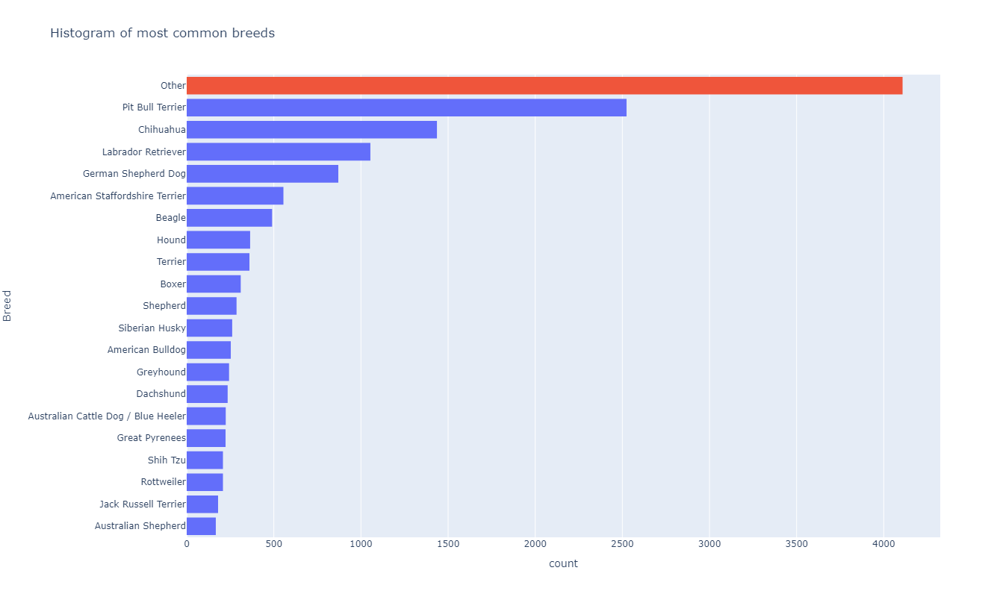

In [12]:
#2.4 Most common breeds
mostCommon = tdf.groupby(tdf['breed_primary']).size().sort_values(ascending = False).head(20)

tdf['breed_category'] = "Other"
mask = tdf['breed_primary'].isin(mostCommon.index)
tdf.loc[mask, 'breed_category'] = tdf.loc[mask,'breed_primary']

fig = px.histogram(tdf, y="breed_category", height=800, title='Histogram of most common breeds', labels={"breed_category":"Breed"}, 
                   category_orders={'breed_category' : ["Other"]},
                  color=tdf['breed_category']=='Other')
fig.update_yaxes(categoryorder='total ascending')
fig.update_layout(showlegend=False)
fig.update
fig.show()

***

## Bivariate analysis

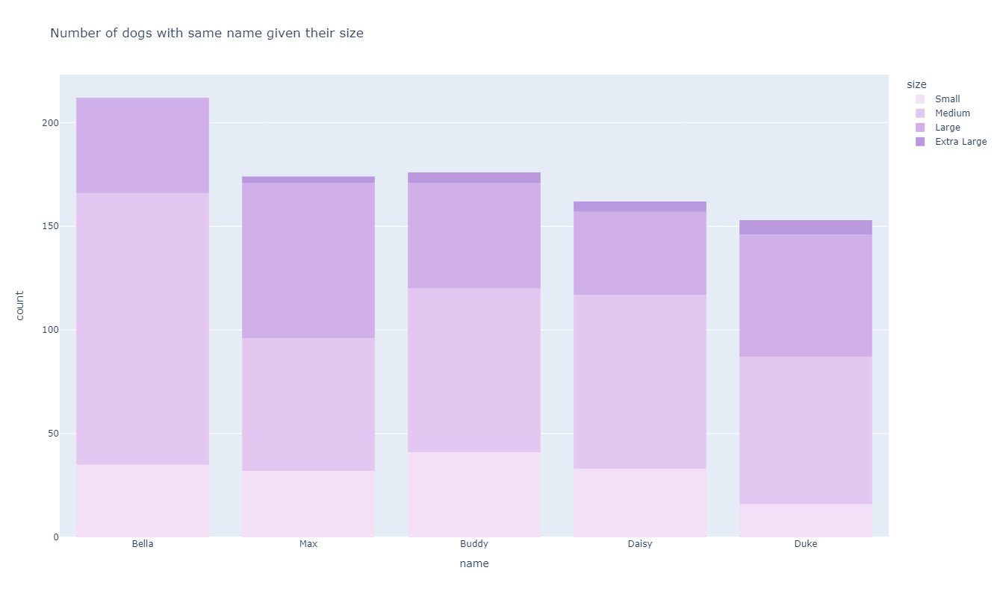

In [13]:
#3.1 Distrubution of names given the dog size
import plotly.express as px

mostCommon = df['name'].str.lower().str.capitalize().value_counts().head(5)
mask = df['name'].isin(mostCommon.index)

ndf = df.loc[mask]

fig = px.histogram(ndf, x='name', color='size', title = 'Number of dogs with same name given their size',
             category_orders={'name' : ['Bella', 'Max', 'Buddy', 'Daisy', 'Duke'], 'size' : ['Small', 'Medium', 'Large', 'Extra Large']},
            color_discrete_sequence=px.colors.sequential.Purp)

fig.update_layout(height = 800)
fig.show()

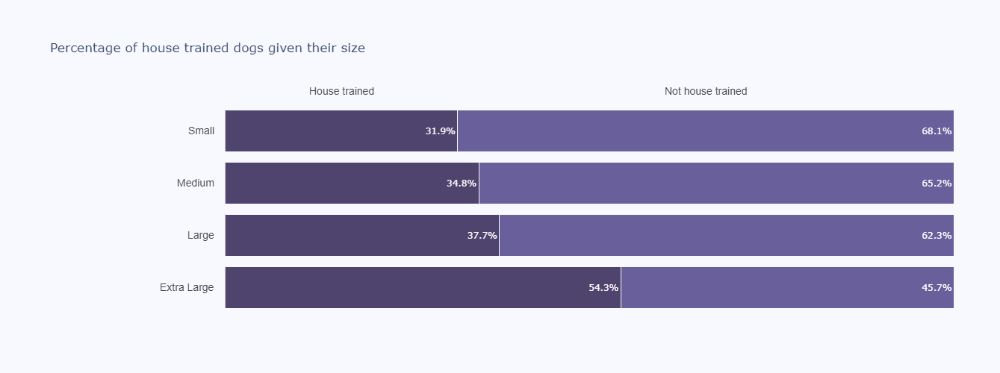

In [14]:
#3.2 Distribution of house trained dogs given their size

import plotly.graph_objects as go

top_labels = ['House trained', 'Not house trained']
colors = ['rgba(38, 24, 74, 0.8)', 'rgba(71, 58, 131, 0.8)']

x_data_t = df.loc[df['house_trained'] == True].groupby('size')['size'].count()
x_data_f = df.loc[df['house_trained'] == False].groupby('size')['size'].count()

sizes = pd.Series(0, index=['Extra Large', 'Large', 'Medium', 'Small'])

x_data_t = x_data_t.reindex(sizes.index, fill_value=0)
x_data_f = x_data_f.reindex(sizes.index, fill_value=0)

x_data = []
for x in range(len(x_data_t)):
    row = []
    tot = x_data_t[x] + x_data_f[x]
    row.append(x_data_t[x] / tot * 100)
    row.append(x_data_f[x] / tot * 100)
    x_data.append(row)


y_data = ['Extra Large', 'Large', 'Medium', 'Small']
fig = go.Figure()

for i in range(0, len(x_data[0])):
    for xd, yd in zip(x_data, y_data):
        fig.add_trace(go.Bar(
            x=[xd[i]], y=[yd],
            orientation='h',
            marker=dict(
                color=colors[i],
                line=dict(color='rgb(248, 248, 249)', width=1)
            )
        ))

fig.update_layout(
    xaxis=dict(
        showgrid=False,
        showline=False,
        showticklabels=False,
        zeroline=False,
        domain=[0.15, 1]
    ),
    yaxis=dict(
        showgrid=False,
        showline=False,
        showticklabels=False,
        zeroline=False,
    ),
    barmode='stack',
    paper_bgcolor='rgb(248, 248, 255)',
    plot_bgcolor='rgb(248, 248, 255)',
    margin=dict(l=120, r=10, t=140, b=80),
    showlegend=False,
)

annotations = []

for yd, xd in zip(y_data, x_data):
    # labeling the y-axis
    annotations.append(dict(xref='paper', yref='y',
                            x=0.14, y=yd,
                            xanchor='right',
                            text=str(yd),
                            font=dict(family='Arial', size=14,
                                      color='rgb(67, 67, 67)'),
                            showarrow=False, align='right'))
    # labeling the first Likert scale (on the top)
    if yd == y_data[-1]:
        annotations.append(dict(xref='x', yref='paper',
                                x=xd[0] / 2, y=1.1,
                                text=top_labels[0],
                                font=dict(family='Arial', size=14,
                                          color='rgb(67, 67, 67)'),
                                showarrow=False))
    space = xd[0]
    for i in range(1, len(xd)):
            # labeling the Likert scale
            if yd == y_data[-1]:
                annotations.append(dict(xref='x', yref='paper',
                                        x=space + (xd[i]/2), y=1.1,
                                        text=top_labels[i],
                                        font=dict(family='Arial', size=14,
                                                  color='rgb(67, 67, 67)'),
                                        showarrow=False))
            space += xd[i]

fig.update_layout(title='Percentage of house trained dogs given their size', annotations=annotations)
fig.update_layout(height = 500)
fig.update_traces(textposition='inside', texttemplate = "%{x:.1f}%", textangle=0)

fig.show()

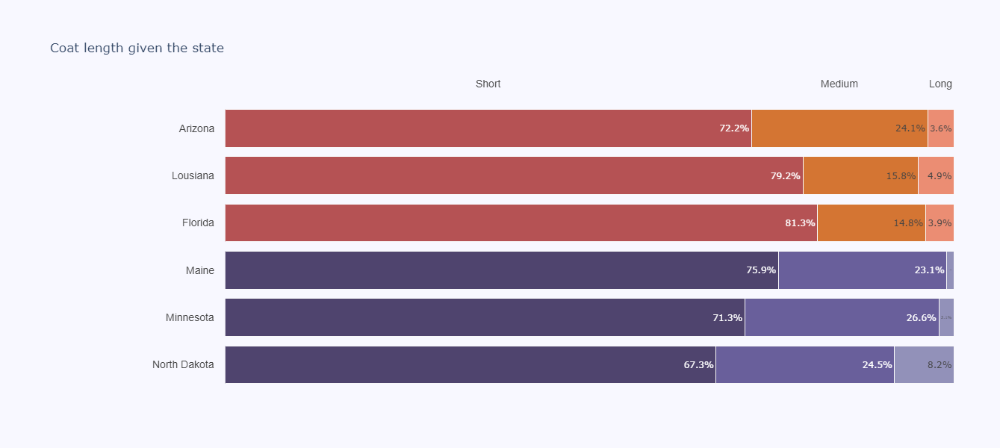

In [15]:
#3.2 Distribution of coat length given the country (cold/hot)
#cold = ND, MN, ME
#hot = FL, LA, AZ

states = pd.Series(0, index=['ND', 'MN', 'ME', 'FL', 'LA', 'AZ'])

top_labels = ['Short', 'Medium', 'Long']
colorsCold = ['rgba(38, 24, 74, 0.8)', 'rgba(71, 58, 131, 0.8)', 'rgba(122, 120, 168, 0.8)']
colorsHot = ['rgba(165, 42, 42, 0.8)', 'rgba(204, 85, 0, 0.8)', 'rgba(233, 116, 81, 0.8)']

mask = df['contact_state'].isin(states.index)
x_data_s = df.loc[(df['coat'] == 'Short') & mask].groupby('contact_state')['contact_state'].count()
x_data_m = df.loc[(df['coat'] == 'Medium') & mask].groupby('contact_state')['contact_state'].count()
x_data_l = df.loc[(df['coat'] == 'Long') & mask].groupby('contact_state')['contact_state'].count()

x_data_s = x_data_s.reindex(states.index, fill_value=0)
x_data_m = x_data_m.reindex(states.index, fill_value=0)
x_data_l = x_data_l.reindex(states.index, fill_value=0)

x_data = []
for x in range(len(states)):
    row = []
    tot = x_data_s[x] + x_data_m[x] + x_data_l[x]
    row.append(x_data_s[x] / tot * 100)
    row.append(x_data_m[x] / tot * 100)
    row.append(x_data_l[x] / tot * 100)
    x_data.append(row)

y_data = ['North Dakota', 'Minnesota', 'Maine', 'Florida', 'Lousiana', 'Arizona']
fig = go.Figure()

for i in range(0, len(x_data[0])):
    count = 0;
    for xd, yd in zip(x_data, y_data):
        # differentiate color for hot and cold states
        if(count > 2):
            fig.add_trace(go.Bar(
                x=[xd[i]], y=[yd],
                orientation='h',
                marker=dict(
                    color=colorsHot[i],
                    line=dict(color='rgb(248, 248, 249)', width=1)
                )
            ))
        else:
            fig.add_trace(go.Bar(
                x=[xd[i]], y=[yd],
                orientation='h',
                marker=dict(
                    color=colorsCold[i],
                    line=dict(color='rgb(248, 248, 249)', width=1)
                )
            ))
        count = count + 1

fig.update_layout(
    xaxis=dict(
        showgrid=False,
        showline=False,
        showticklabels=False,
        zeroline=False,
        domain=[0.15, 1]
    ),
    yaxis=dict(
        showgrid=False,
        showline=False,
        showticklabels=False,
        zeroline=False,
    ),
    barmode='stack',
    paper_bgcolor='rgb(248, 248, 255)',
    plot_bgcolor='rgb(248, 248, 255)',
    margin=dict(l=120, r=10, t=140, b=80),
    showlegend=False,
)

annotations = []

for yd, xd in zip(y_data, x_data):
    # labeling the y-axis
    annotations.append(dict(xref='paper', yref='y',
                            x=0.14, y=yd,
                            xanchor='right',
                            text=str(yd),
                            font=dict(family='Arial', size=14,
                                      color='rgb(67, 67, 67)'),
                            showarrow=False, align='right'))
    # labeling the first Likert scale (on the top)
    if yd == y_data[-1]:
        annotations.append(dict(xref='x', yref='paper',
                                x=xd[0] / 2, y=1.1,
                                text=top_labels[0],
                                font=dict(family='Arial', size=14,
                                          color='rgb(67, 67, 67)'),
                                showarrow=False))
    space = xd[0]
    for i in range(1, len(xd)):
            # labeling the Likert scale
            if yd == y_data[-1]:
                annotations.append(dict(xref='x', yref='paper',
                                        x=space + (xd[i]/2), y=1.1,
                                        text=top_labels[i],
                                        font=dict(family='Arial', size=14,
                                                  color='rgb(67, 67, 67)'),
                                        showarrow=False))
            space += xd[i]

fig.update_layout(title='Coat length given the state', annotations=annotations)
fig.update_layout(height = 600)
fig.update_traces(textposition='inside', texttemplate = "%{x:.1f}%", textangle=0)

fig.show()

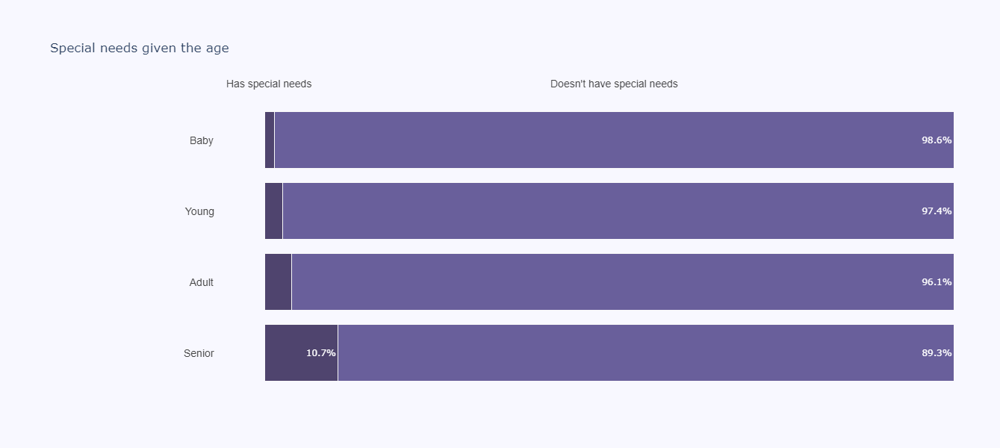

In [16]:
#3.3 Special needs given the age

top_labels = ['Has special needs', 'Doesn\'t have special needs']
colors = ['rgba(38, 24, 74, 0.8)', 'rgba(71, 58, 131, 0.8)']

x_data_t = df.loc[df['special_needs'] == True].groupby('age')['age'].count()
x_data_f = df.loc[df['special_needs'] == False].groupby('age')['age'].count()

ages = pd.Series(0, index=['Senior', 'Adult', 'Young', 'Baby'])

x_data_t = x_data_t.reindex(ages.index, fill_value=0)
x_data_f = x_data_f.reindex(ages.index, fill_value=0)

x_data = []
for x in range(len(x_data_t)):
    row = []
    tot = x_data_t[x] + x_data_f[x]
    row.append(x_data_t[x] / tot * 100)
    row.append(x_data_f[x] / tot * 100)
    x_data.append(row)
    

y_data = ['Senior', 'Adult', 'Young', 'Baby']
fig = go.Figure()

for i in range(0, len(x_data[0])):
    for xd, yd in zip(x_data, y_data):
        fig.add_trace(go.Bar(
            x=[xd[i]], y=[yd],
            orientation='h',
            marker=dict(
                color=colors[i],
                line=dict(color='rgb(248, 248, 249)', width=1)
            )
        ))

fig.update_layout(
    xaxis=dict(
        showgrid=False,
        showline=False,
        showticklabels=False,
        zeroline=False,
        domain=[0.15, 1]
    ),
    yaxis=dict(
        showgrid=False,
        showline=False,
        showticklabels=False,
        zeroline=False,
    ),
    barmode='stack',
    paper_bgcolor='rgb(248, 248, 255)',
    plot_bgcolor='rgb(248, 248, 255)',
    margin=dict(l=120, r=10, t=140, b=80),
    showlegend=False,
)

annotations = []

for yd, xd in zip(y_data, x_data):
    # labeling the y-axis
    annotations.append(dict(xref='paper', yref='y',
                            x=0.14, y=yd,
                            xanchor='right',
                            text=str(yd),
                            font=dict(family='Arial', size=14,
                                      color='rgb(67, 67, 67)'),
                            showarrow=False, align='right'))
   
    # labeling the first Likert scale (on the top)
    if yd == y_data[-1]:
        annotations.append(dict(xref='x', yref='paper',
                                x=xd[0] / 2, y=1.1,
                                text=top_labels[0],
                                font=dict(family='Arial', size=14,
                                          color='rgb(67, 67, 67)'),
                                showarrow=False))
    space = xd[0]
    for i in range(1, len(xd)):
           
            # labeling the Likert scale
            if yd == y_data[-1]:
                annotations.append(dict(xref='x', yref='paper',
                                        x=space + (xd[i]/2), y=1.1,
                                        text=top_labels[i],
                                        font=dict(family='Arial', size=14,
                                                  color='rgb(67, 67, 67)'),
                                        showarrow=False))
            space += xd[i]

fig.update_layout(title='Special needs given the age', annotations=annotations)
fig.update_layout(height = 600, uniformtext_minsize=12, uniformtext_mode='hide')
fig.update_traces(textposition='inside', texttemplate = "%{x:.1f}%", textangle=0)

fig.show()

***

## Maps

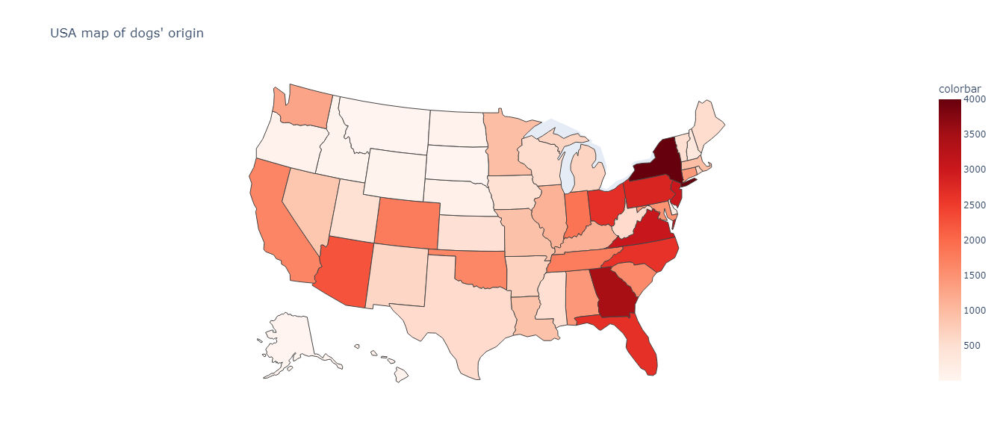

In [17]:
#4.1 Map of dogs' origin

import plotly.offline as po

states = df.groupby('contact_state')['contact_state'].count()

data = dict(type = 'choropleth', 
            locations = states.index, 
            locationmode = 'USA-states', 
            z = states, 
            colorscale = 'Reds', 
            colorbar = {'title' : 'colorbar'})
layout = dict(title = 'USA map of dogs\' origin', 
              geo = dict(scope='usa' , 
                       showlakes = False, 
                       lakecolor = 'rgb(0,191,255)'),
             height = 600)
x = go.Figure(data = [data], 
              layout = layout)
po.iplot(x)

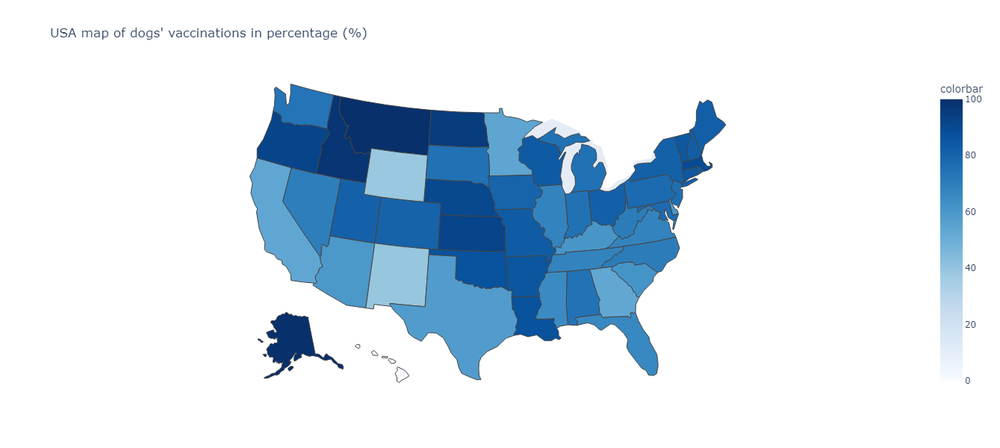

In [18]:
#4.2 Map of dogs' percentage of vaccinations

vaccinations = df.loc[df['shots_current'] == True].groupby('contact_state')['contact_state'].count()

vaccinations = vaccinations.reindex(states.index, fill_value=0)

for x in range(len(vaccinations)):
    vaccinations[x] = vaccinations[x] / states[x] * 100

data = dict(type = 'choropleth', 
            locations = vaccinations.index, 
            locationmode = 'USA-states', 
            z = vaccinations, 
            colorscale = 'Blues', 
            colorbar = {'title' : 'colorbar'})
layout = dict(title = 'USA map of dogs\' vaccinations in percentage (%)', 
              geo = dict(scope='usa' , 
                       showlakes = False, 
                       lakecolor = 'rgb(0,191,255)'),
             height = 600)
x = go.Figure(data = [data], 
              layout = layout)
po.iplot(x)

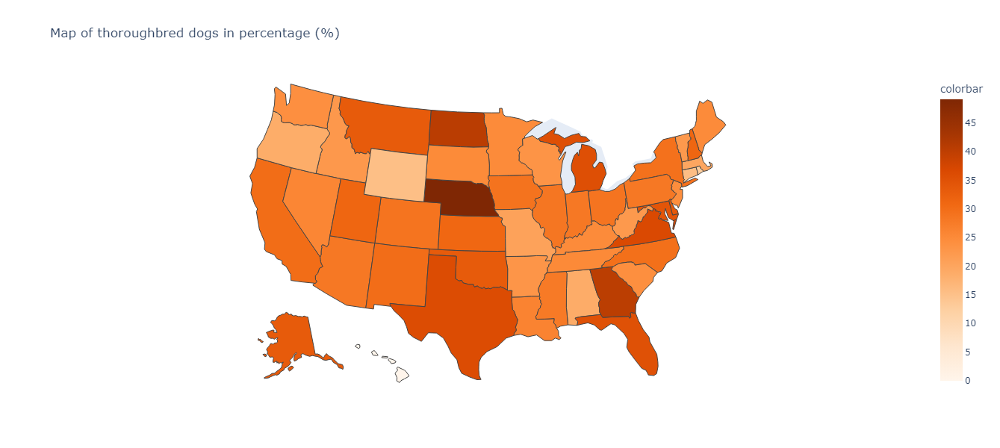

In [19]:
#4.2 Map of thoroughbred dogs in percentage

thoroughbred = df.loc[df['breed_mixed'] == False].groupby('contact_state')['contact_state'].count()

thoroughbred = thoroughbred.reindex(states.index, fill_value=0)

for x in range(len(thoroughbred)):
    thoroughbred[x] = thoroughbred[x] / states[x] * 100

data = dict(type = 'choropleth', 
            locations = thoroughbred.index, 
            locationmode = 'USA-states', 
            z = thoroughbred, 
            colorscale = 'Oranges', 
            colorbar = {'title' : 'colorbar'})
layout = dict(title = 'Map of thoroughbred dogs in percentage (%)', 
              geo = dict(scope='usa' , 
                       showlakes = False, 
                       lakecolor = 'rgb(0,191,255)'),
             height = 600)
x = go.Figure(data = [data], 
              layout = layout)
po.iplot(x)

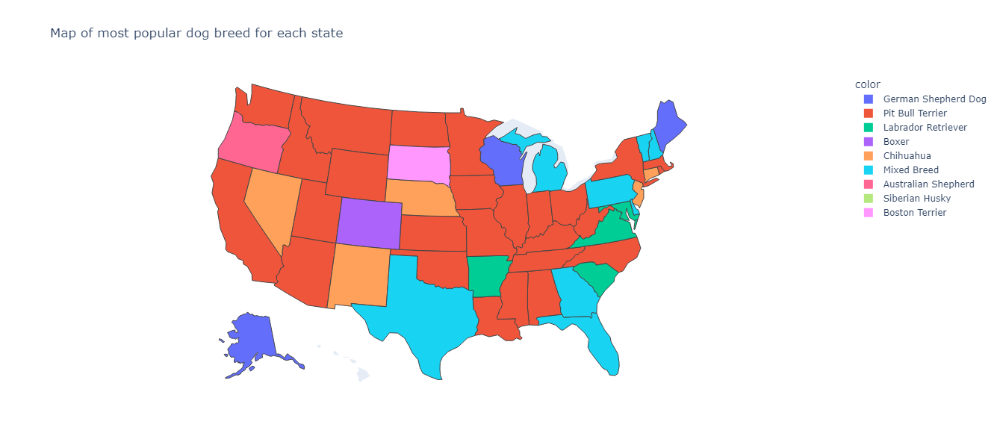

In [20]:
#4.3 Map of most popular breed per country

mask = df['breed_mixed'] == False

tmp = df.loc[mask].groupby('contact_state')['breed_primary'].describe()
mostCommon = pd.Series(data=tmp.top, index=tmp.index)
mostCommon
        
fig = px.choropleth(df, locations = mostCommon.index, 
            locationmode = 'USA-states', 
            color = mostCommon,
            height = 600,
            title = 'Map of most popular dog breed for each state')

fig.update_layout( geo = dict(scope='usa' , 
                       showlakes = False))
fig.show()

***

## WordCloud

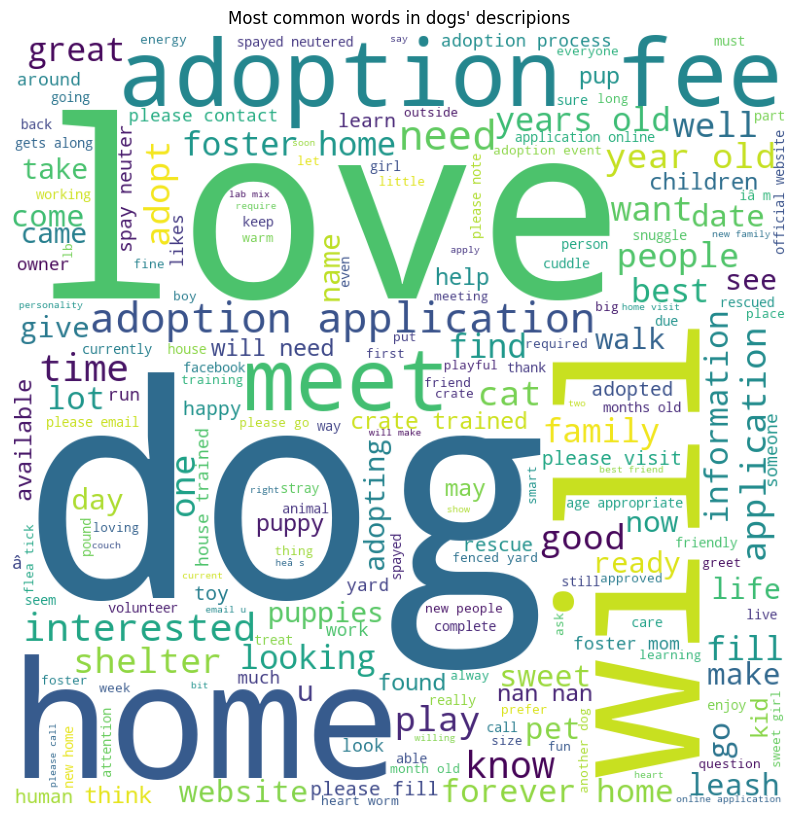

In [21]:
#5.1 Most common words in all description

# importing all necessary modules
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import pandas as pd
 
comment_words = ''
stopwords = set(STOPWORDS)
 
# iterate through the csv file
for val in df['description']:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.title("Most common words in dogs' descripions")
plt.tight_layout(pad = 0)
 
plt.show()

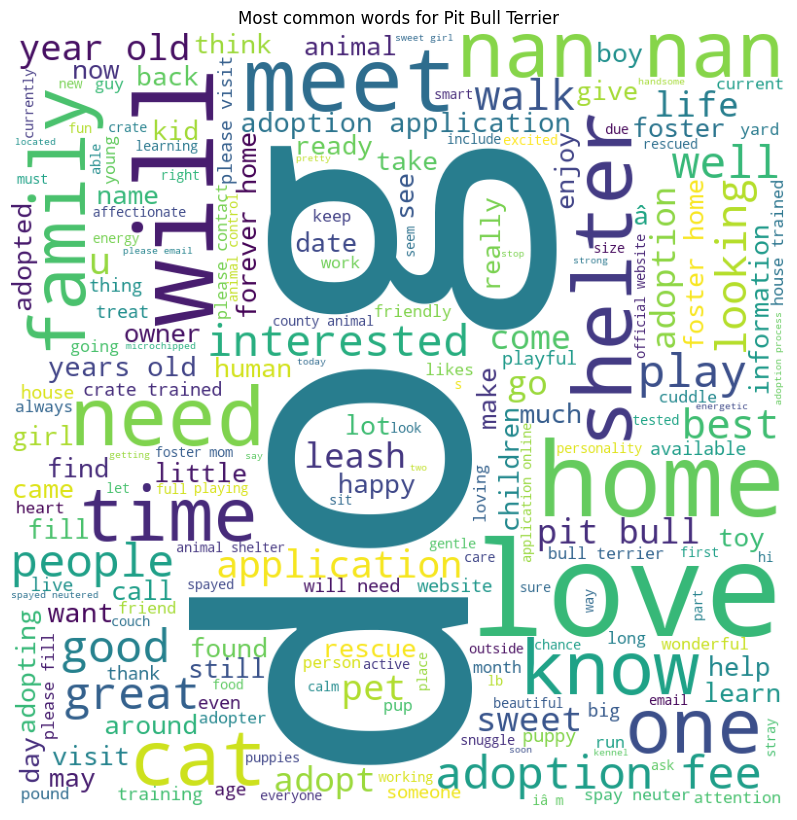

In [22]:
#5.2 Most common words for Pit Bull Terrier
 
comment_words = ''
stopwords = set(STOPWORDS)
 
mask = (df['breed_mixed'] == False) & (df['breed_primary'] == 'Pit Bull Terrier')
    
# iterate through the csv file
for val in df.loc[mask, 'description']:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.title("Most common words for Pit Bull Terrier")
plt.tight_layout(pad = 0)
 
plt.show()

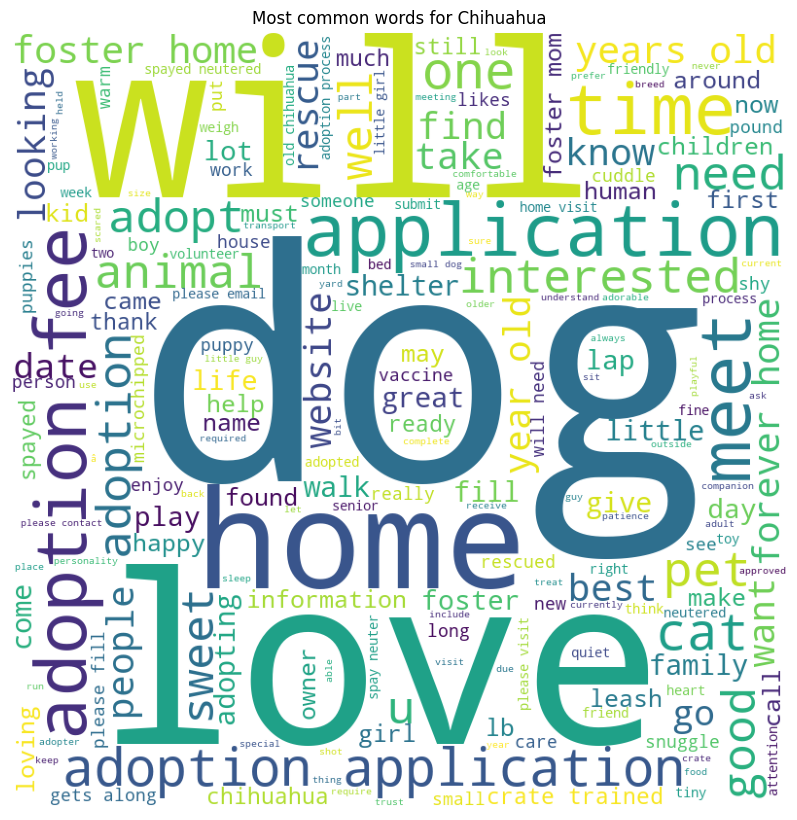

In [23]:
#5.3 Most common words for Chihuahua
 
comment_words = ''
stopwords = set(STOPWORDS)
 
mask = (df['breed_mixed'] == False) & (df['breed_primary'] == 'Chihuahua')
    
# iterate through the csv file
for val in df.loc[mask, 'description']:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.title("Most common words for Chihuahua")
plt.tight_layout(pad = 0)
 
plt.show()

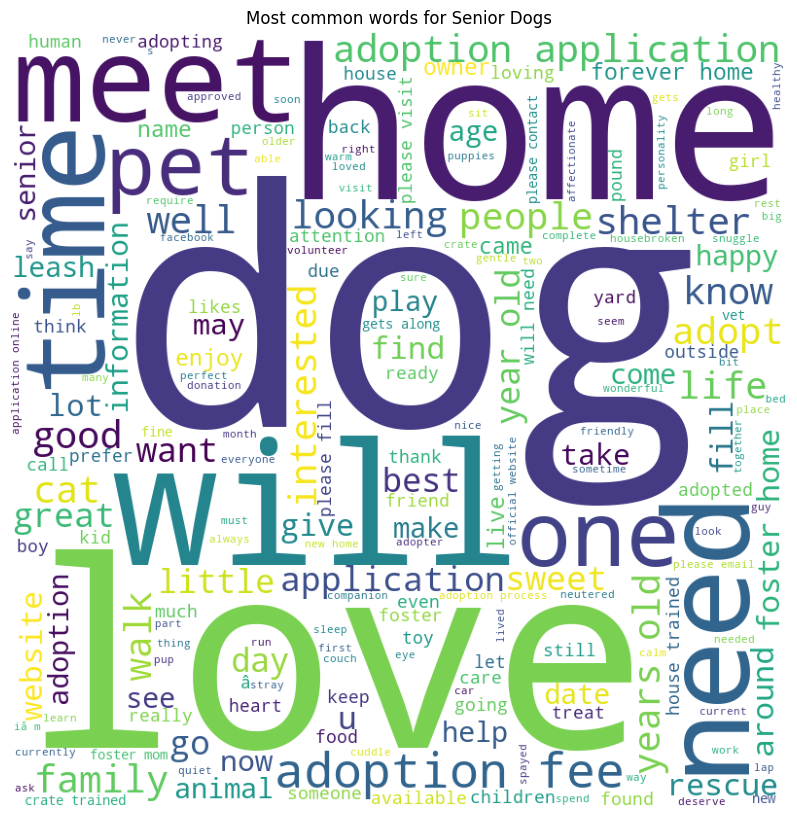

In [24]:
#5.5 Most common words for Senior Dogs
 
comment_words = ''
stopwords = set(STOPWORDS)
 
mask = (df['age'] == 'Senior')
    
# iterate through the csv file
for val in df.loc[mask, 'description']:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.title("Most common words for Senior Dogs")
plt.tight_layout(pad = 0)
 
plt.show()

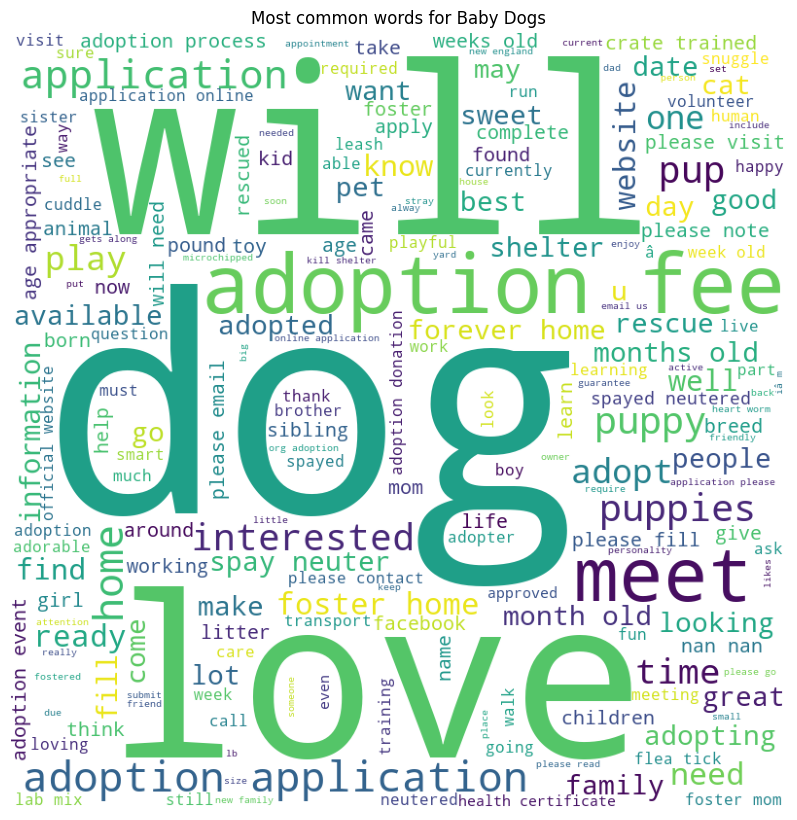

In [25]:
#5.5 Most common words for Baby Dogs
 
comment_words = ''
stopwords = set(STOPWORDS)
 
mask = (df['age'] == 'Baby')
    
# iterate through the csv file
for val in df.loc[mask, 'description']:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.title("Most common words for Baby Dogs")
plt.tight_layout(pad = 0)
 
plt.show()

Unfortunatly, we can tell how the most common words don't vary in a remarkable way.

***

### Conclusions
This is the end of my analisys, I hope you enjoied my research!

As my first data analisys project, I'm rather satisfied about my work, altought I have to recognize how further researches could have been done.

The lack of data from most of the countries was surely the biggest issue, so integrating data from different datasets would surely improve the quality of my work.

Thank you for your attention, I hope to see you in my next project!